In [9]:
import pandas as pd
import numpy as np
import tqdm
import folium
import random
import seaborn as sns
from math import radians
from tqdm.notebook import tqdm
from sklearn.cluster import KMeans
# from sklearn.cluster import KMeans, DBSCAN, HDBSCAN
from sklearn.metrics import silhouette_score,  davies_bouldin_score, calinski_harabasz_score, make_scorer
from sklearn.neighbors import KNeighborsClassifier
from plotly.colors import DEFAULT_PLOTLY_COLORS, PLOTLY_SCALES
from mlxtend.preprocessing import TransactionEncoder
from sklearn.metrics.pairwise import haversine_distances

import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.float_format', lambda x: '%.6f' % x)

<h1>Clustering techniques and grid search</h1>

In [4]:
pallete = """aliceblue, aqua, aquamarine, azure,
beige, bisque, blanchedalmond, blue,
blueviolet, brown, burlywood, cadetblue,
chartreuse, chocolate, coral, cornflowerblue,
cornsilk, crimson, cyan, darkblue, darkcyan,
darkgoldenrod, darkgray, darkgrey, darkgreen,
darkkhaki, darkmagenta, darkolivegreen, darkorange,
darkorchid, darkred, darksalmon, darkseagreen,
darkslateblue, darkslategray, darkslategrey,
darkturquoise, darkviolet, deeppink, deepskyblue,
dimgray, dimgrey, dodgerblue, firebrick,
floralwhite, forestgreen, fuchsia, gainsboro,
ghostwhite, gold, goldenrod, gray, grey, green,
greenyellow, honeydew, hotpink, indianred, indigo,
ivory, khaki, lavender, lavenderblush, lawngreen,
lemonchiffon, lightblue, lightcoral, lightcyan,
lightgoldenrodyellow, lightgray, lightgrey,
lightgreen, lightpink, lightsalmon, lightseagreen,
lightskyblue, lightslategray, lightslategrey,
lightsteelblue, lightyellow, lime, limegreen,
linen, magenta, maroon, mediumaquamarine,
mediumblue, mediumorchid, mediumpurple,
mediumseagreen, mediumslateblue, mediumspringgreen,
mediumturquoise, mediumvioletred, midnightblue,
mintcream, mistyrose, moccasin, navajowhite, navy,
oldlace, olive, olivedrab, orange, orangered,
orchid, palegoldenrod, palegreen, paleturquoise,
palevioletred, papayawhip, peachpuff, peru, pink,
plum, powderblue, purple, red, rosybrown,
royalblue, saddlebrown, salmon, sandybrown,
seagreen, seashell, sienna, silver, skyblue,
slateblue, slategray, slategrey, snow, springgreen,
steelblue, tan, teal, thistle, tomato, turquoise,
violet, wheat, yellow,
yellowgreen""".split(',')

colors = [s.replace('\n','').strip() for s in pallete]
l = len(colors)
random.shuffle(colors)

In [5]:
def haversine(latlon1, latlon2):
    lat1, lon1 = latlon1
    lat2, lon2 = latlon2
    R = 6371000  # radius of Earth in meters
    phi_1 = radians(lat1)
    phi_2 = radians(lat2)

    delta_phi = radians(lat2 - lat1)
    delta_lambda = radians(lon2 - lon1)

    a = (np.sin(delta_phi / 2) ** 2 +
         np.cos(phi_1) * np.cos(phi_2) * np.sin(delta_lambda / 2) ** 2)

    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))

    meters = R * c  # output distance in meters
    return meters/1000

In [6]:
data = pd.read_csv('.\Olist_data/customer_data.csv', index_col= 'Unnamed: 0')
data.dropna(inplace= True)
df = data.drop_duplicates(subset= ['geolocation_lat','geolocation_lng'])

In [7]:
mapf = folium.Map(
    location= [df.geolocation_lat.mean(), df.geolocation_lng.mean()],
    zoom_start= 4,
    tiles= 'OpenStreetMap',
    height= 550,
)

circles = df.apply(
    lambda row: folium.CircleMarker(
        location= [row.geolocation_lat, row.geolocation_lng],
        radius= 1,
        fill= True,
        fill_color= '#009999',
        color= '#009999',
        popup= ""+str(row.geolocation_lat)+", "+str(row.geolocation_lng)
    ).add_to(mapf),
    axis= 1
)
# mapf.save('/home/raj/All_locations.html')
mapf

<h2>DBSCAN clustering algorithm</h2>

In [ ]:
model = DBSCAN(eps= 8, min_samples= 15, metric= haversine).fit(df[['geolocation_lat','geolocation_lng']])
df['CLUSTER_dbscan']= model.labels_

mapf = folium.Map(
    location= [df.geolocation_lat.mean(),df.geolocation_lng.mean()],
    zoom_start = 3.5,
    tiles= 'OpenStreetMap',
    height= 500
)

circles= df.apply(
    lambda row: folium.CircleMarker(
        location= [row.geolocation_lat, row.geolocation_lng],
        radius= 1,
        popup= ""+str(row.geolocation_lat)+", "+str(row.geolocation_lng)+"\n"+str(row.CLUSTER_dbscan),
        color= [colors[row.CLUSTER_dbscan % l] if row.CLUSTER_dbscan != -1 else '#00000F'],
        fill= True,
        fill_color= [colors[row.CLUSTER_dbscan % l] if row.CLUSTER_dbscan != -1 else '#00000F']
    ).add_to(mapf),
    axis= 1
)
# mapf.save('/home/raj/DBSCAN_clustering.html')
mapf

In [ ]:
cols= ["geolocation_lat","geolocation_lng"]

print("DBSCAN metrics")
print(f'Number of clusters: {len(np.unique(df.CLUSTER_dbscan))}')
print(f'Number of outliers: {len(df[df.CLUSTER_dbscan == -1])}')

# pred= [(c+2)*x if x == -1 else x for c,x in enumerate(df.CLUSTER_dbscan)]
# print(f'Silhouette score, with outliers as singletons: {silhouette_score(df[cols],pred,metric= haversine)}')

temp = df[df.CLUSTER_dbscan != -1]
print(f'Silhouette score without outliers: {silhouette_score(temp[cols],temp.CLUSTER_dbscan, metric=haversine)}')

davies_bouldin = davies_bouldin_score(temp[cols], temp['CLUSTER_dbscan'])
print(f'Davies-Bouldin Index without outliers: {davies_bouldin}')

# Calculate Calinski-Harabasz Index
calinski_harabasz = calinski_harabasz_score(temp[cols], temp['CLUSTER_dbscan'])
print(f'Calinski-Harabasz Index without outliers: {calinski_harabasz}')

In [ ]:
eps_values = list(range(1,30,5))
min_samples_values = list(range(5,50,5))

all_scores = {}

run_count = 0

for eps in tqdm(eps_values):
    for min_samples in tqdm(min_samples_values):
        print(run_count, eps, min_samples)
        grid_df = df[['geolocation_lat','geolocation_lng']].copy()
        
        dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric= haversine)
        labels = dbscan.fit_predict(grid_df)
        
        grid_df['cluster'] = labels
        grid_df = grid_df[grid_df.cluster != -1]
        
        print(grid_df.shape, len(grid_df.cluster.unique()))
        
        if  len(grid_df.cluster.unique()) > 1:
            silhouette = silhouette_score(grid_df[['geolocation_lat','geolocation_lng']], grid_df.cluster, metric= haversine)
            davies_bouldin = davies_bouldin_score(grid_df[['geolocation_lat','geolocation_lng']], grid_df.cluster)
            calinski_harabasz = calinski_harabasz_score(grid_df[['geolocation_lat','geolocation_lng']], grid_df.cluster)

            print(silhouette, davies_bouldin, calinski_harabasz)

            all_scores[f'run_{run_count+1}'] = {
                'silhouette_score': silhouette,
                'davies_bouldin_score': davies_bouldin,
                'calinski_harabasz_score': calinski_harabasz,
                'eps': eps,
                'min_sample': min_samples
            }
            
        run_count += 1

In [ ]:
db = pd.read_csv('.\Olist_data/dbscan_grid_search_results.csv')
db.head()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming you have the scores stored in arrays like silhouette_scores, davies_bouldin_scores, calinski_harabasz_scores

num_runs = len(db)  # Assuming the number of runs is the same for all scores

fig, axs = plt.subplots(3, 1, figsize=(10, 12))

# Silhouette Score
axs[0].plot(np.arange(1, num_runs + 1), db.silhouette_score, marker='o')
axs[0].set_title('Silhouette Score')

# Davies Bouldin Score
axs[1].plot(np.arange(1, num_runs + 1), db.davies_bouldin_score, marker='o')
axs[1].set_title('Davies Bouldin Score')

# Calinski Harabasz Score
axs[2].plot(np.arange(1, num_runs + 1), db.calinski_harabasz_score, marker='o')
axs[2].set_title('Calinski Harabasz Score')

plt.tight_layout()
plt.show()

<h2>HDBSCAN Clustering algorithm</h2>

In [ ]:
model = HDBSCAN(min_cluster_size= 5, min_samples= 5, alpha= 0.1, cluster_selection_epsilon= 3, metric= haversine).fit(df[['geolocation_lat','geolocation_lng']])
df['CLUSTER_hdbscan']= model.labels_

mapf = folium.Map(
    location= [df.geolocation_lat.mean(),df.geolocation_lng.mean()],
    zoom_start = 3.5,
    tiles= 'OpenStreetMap',
    height= 500
)

folium.GeoJson(filtered_geojson, name='world_borders', style_function= style_function).add_to(mapf)
folium.GeoJson(brazil_geojson, name='brazil_borders', style_function= style_function_brazil).add_to(mapf)

circles= df.apply(
    lambda row: folium.CircleMarker(
        location= [row.geolocation_lat, row.geolocation_lng],
        radius= 1,
        popup= ""+str(row.geolocation_lat)+", "+str(row.geolocation_lng)+"\n"+str(row.CLUSTER_hdbscan),
        color= [colors[row.CLUSTER_hdbscan % l] if row.CLUSTER_hdbscan != -1 else '#00000F'],
        fill= True,
        fill_color= [colors[row.CLUSTER_hdbscan % l] if row.CLUSTER_hdbscan != -1 else '#00000F'],
        fill_opacity=0.5
    ).add_to(mapf),
    axis= 1
)
# mapf.save('/home/raj/DBSCAN_clustering.html')
mapf

In [ ]:
cols= ["geolocation_lat","geolocation_lng"]

temp = df[df.CLUSTER_hdbscan != -1]
distances = haversine_distances(temp[cols]) * 6371000/1000

print(f'Silhouette score without outliers: {silhouette_score(temp[cols], temp["CLUSTER_hdbscan"], metric=haversine)}')

davies_bouldin = davies_bouldin_score(temp[cols], temp['CLUSTER_hdbscan'])
print(f'Davies-Bouldin Index without outliers: {davies_bouldin}')

# Calculate Calinski-Harabasz Index
calinski_harabasz = calinski_harabasz_score(temp[cols], temp['CLUSTER_hdbscan'])
print(f'Calinski-Harabasz Index without outliers: {calinski_harabasz}')

In [ ]:
min_cluster_size= [5, 10, 15, 20, 25, 30, 35, 40]
min_samples= [1, 2, 5, 10]
alpha= [0.1, 0.5, 1.0]
cluster_selection_epsilon= [3, 5, 10, 20]

perms = list(product(min_samples, alpha, cluster_selection_epsilon, min_cluster_size))

all_scores = {}
run_count = 0

for min_sample, alp, eps, min_cluster in tqdm(perms):
        print(run_count, min_cluster, min_sample, alp, eps)
        grid_df = df[['geolocation_lat','geolocation_lng']].copy()
        
        hdbscan = HDBSCAN(min_cluster_size= min_cluster, min_samples= min_sample, alpha= alp, cluster_selection_epsilon= eps,
                        metric= 'precomputed', n_jobs= 2)
        labels = hdbscan.fit(distances).labels_
        
        grid_df['cluster'] = pd.Series(labels, index= grid_df.index)
        grid_df = grid_df[grid_df.cluster != -1]
        
        print(grid_df.shape, len(grid_df.cluster.unique()))
        
        if  len(grid_df.cluster.unique()) > 1:
            d = haversine_distances(grid_df[['geolocation_lat','geolocation_lng']])  * 6371000/1000
            silhouette = silhouette_score(d, grid_df.cluster, metric= 'precomputed')
            davies_bouldin = davies_bouldin_score(grid_df[['geolocation_lat','geolocation_lng']], grid_df.cluster)
            calinski_harabasz = calinski_harabasz_score(grid_df[['geolocation_lat','geolocation_lng']], grid_df.cluster)

            print(silhouette, davies_bouldin, calinski_harabasz)

            all_scores[f'run_{run_count+1}'] = {
                'silhouette_score': silhouette,
                'davies_bouldin_score': davies_bouldin,
                'calinski_harabasz_score': calinski_harabasz,
                'eps': eps,
                'min_sample': min_sample,
                'alpha': alp,
                'min_cluster_size': min_cluster
            }
            
        run_count += 1

In [ ]:
hdb = pd.read_csv('./Olist_data/hdbscan_grid_search_results.csv')
hdb.head()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming you have the scores stored in arrays like silhouette_scores, davies_bouldin_scores, calinski_harabasz_scores

num_runs = len(hdb)  # Assuming the number of runs is the same for all scores

fig, axs = plt.subplots(3, 1, figsize=(10, 12))

# Silhouette Score
axs[0].plot(np.arange(1, num_runs + 1), hdb.silhouette_score, marker='o')
axs[0].set_title('Silhouette Score')

# Davies Bouldin Score
axs[1].plot(np.arange(1, num_runs + 1), hdb.davies_bouldin_score, marker='o')
axs[1].set_title('Davies Bouldin Score')

# Calinski Harabasz Score
axs[2].plot(np.arange(1, num_runs + 1), hdb.calinski_harabasz_score, marker='o')
axs[2].set_title('Calinski Harabasz Score')

plt.tight_layout()
plt.show()

<h2>KMeans Clustering algorithm</h2>

In [11]:
cols= ["geolocation_lat","geolocation_lng"]
distances = haversine_distances(df[cols]) * 6371000/1000

In [17]:
model = KMeans(n_clusters = 2, random_state=0, algorithm='haversine').fit(df[cols])
df['CLUSTER_kmeans']= model.labels_

mapf = folium.Map(
    location= [df.geolocation_lat.mean(),df.geolocation_lng.mean()],
    zoom_start = 3.5,
    tiles= 'OpenStreetMap',
    height= 500
)

circles= df.apply(
    lambda row: folium.CircleMarker(
        location= [row.geolocation_lat, row.geolocation_lng],
        radius= 1,
        popup= ""+str(row.geolocation_lat)+", "+str(row.geolocation_lng)+"\n"+str(row.CLUSTER_kmeans),
        color= [colors[row.CLUSTER_kmeans % l] if row.CLUSTER_kmeans != -1 else '#00000F'],
        fill= True,
        fill_color= [colors[row.CLUSTER_kmeans % l] if row.CLUSTER_kmeans != -1 else '#00000F']
    ).add_to(mapf),
    axis= 1
)
# mapf.save('/home/raj/DBSCAN_clustering.html')
mapf

ValueError: Algorithm must be 'auto', 'full' or 'elkan', got haversine instead.

In [51]:
print(df['CLUSTER_kmeans'].value_counts())

6    5350
4    2514
5    2290
2    1449
3    1445
0    1286
1     502
Name: CLUSTER_kmeans, dtype: int64


In [34]:
def kmeans_haversine(data: np.ndarray, n_clusters: int, max_iters: int = 100):
    n_samples, _ = data.shape
    # Initialize centroids randomly
    centroids = data[random.sample(range(n_samples), n_clusters)]
    labels = np.zeros(n_samples)
    inertia = float('inf')

    for _ in range(max_iters):
        # Assign labels based on closest centroid
        for i, point in enumerate(data):
            distances = [haversine(point, centroid) for centroid in centroids]
            labels[i] = np.argmin(distances)
        
        # Update centroids
        new_centroids = np.array([data[labels == j].mean(axis=0) for j in range(n_clusters)])
        inertia = sum([haversine(data[i], centroids[int(label)])**2 for i, label in enumerate(labels)])
        
        # Check for convergence
        if np.allclose(new_centroids, centroids):
            break
        centroids = new_centroids

    return centroids, labels, inertia

In [50]:
n_data = df[cols].to_numpy()  
n_clusters = 7
centroids, labels, inertia = kmeans_haversine(n_data, n_clusters)
df['CLUSTER_kmeans']= labels.astype('int32')

mapf = folium.Map(
    location= [df.geolocation_lat.mean(),df.geolocation_lng.mean()],
    zoom_start = 3.5,
    tiles= 'OpenStreetMap',
    height= 500
)

circles= df.apply(
    lambda row: folium.CircleMarker(
        location= [row.geolocation_lat, row.geolocation_lng],
        radius= 1,
        popup= ""+str(row.geolocation_lat)+", "+str(row.geolocation_lng)+"\n"+str(row.CLUSTER_kmeans),
        color= [colors[row.CLUSTER_kmeans % l] if row.CLUSTER_kmeans != -1 else '#00000F'],
        fill= True,
        fill_color= [colors[row.CLUSTER_kmeans % l] if row.CLUSTER_kmeans != -1 else '#00000F']
    ).add_to(mapf),
    axis= 1
)
# mapf.save('/home/raj/DBSCAN_clustering.html')
mapf

In [43]:
labels.astype('int32')

array([60, 80, 63, ..., 13, 23, 53])

In [36]:
inertia

2817070321.676204

In [40]:
import matplotlib.pyplot as plt

grid_df = df[['geolocation_lat','geolocation_lng']].copy()
n_grid_data = grid_df[cols].to_numpy() 
g_inertias = []
k_values = range(1, 501)
for k in tqdm(k_values, desc="Calculating Inertia for K"):
    centroids, labels, inertia = kmeans_haversine(n_grid_data, n_clusters=k)
    g_inertias.append(inertia)
        
plt.figure()
plt.plot(k_values, g_inertias, '-o')
plt.xlabel('Number of clusters, k')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.show()

KeyboardInterrupt: 

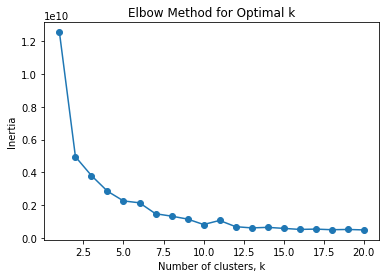

In [49]:
plt.figure()
plt.plot(range(1, 21), g_inertias[:20], '-o')
plt.xlabel('Number of clusters, k')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.show()

In [54]:
df.to_csv("./Olist_data/kmeans_best_value_results.csv")